In [1]:
import cv2
import glob
import random
import pickle
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from image_process import *

In [2]:
# =========== Computed the camera matrix and distortion coefficients ===========
images = glob.glob('camera_cal/calibration*.jpg')
nx = 9  # the number of inside corners in x
ny = 6  # the number of inside corners in y

objpoints = []  # 3D points in real world space
imgpoints = []  # 2D points in image plane

objp = np.zeros((ny * nx, 3), np.float32)
objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

for fname in images:
    img = mpimg.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    if ret:
        imgpoints.append(corners)
        objpoints.append(objp)

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img[:, :, 0].shape[::-1], None, None)
# ==============================================================================

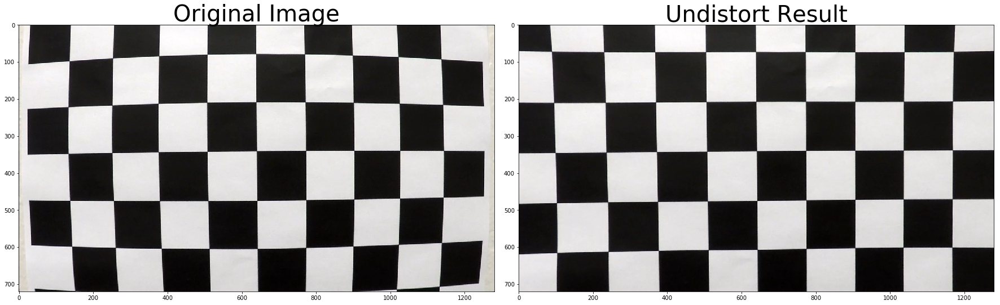

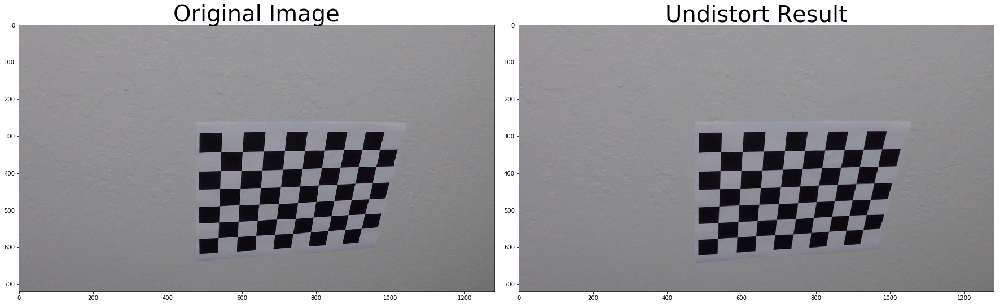

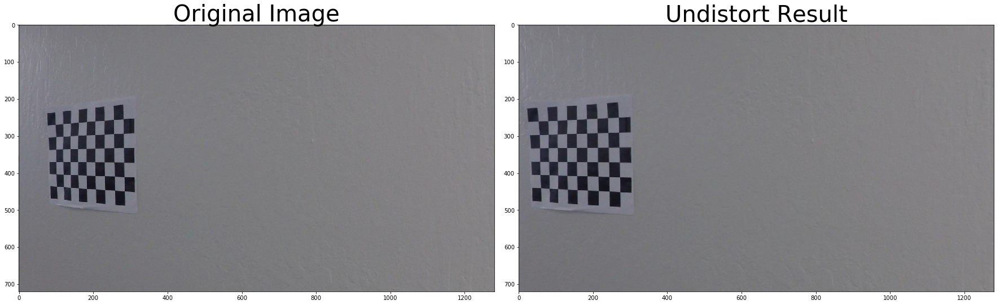

In [3]:
for fname in images[:3]:
    image = mpimg.imread(fname)
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(undist)
    ax2.set_title('Undistort Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

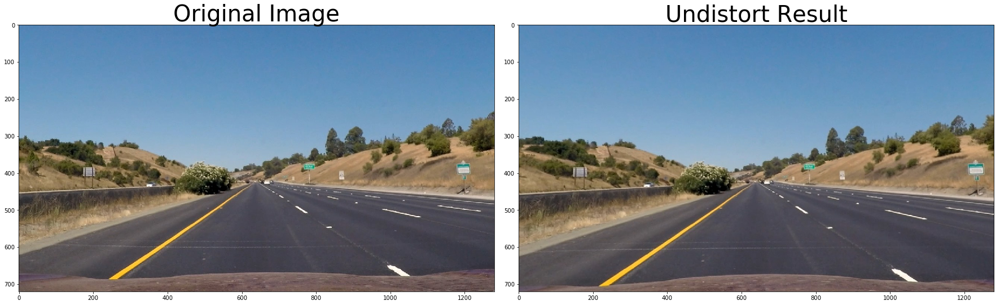

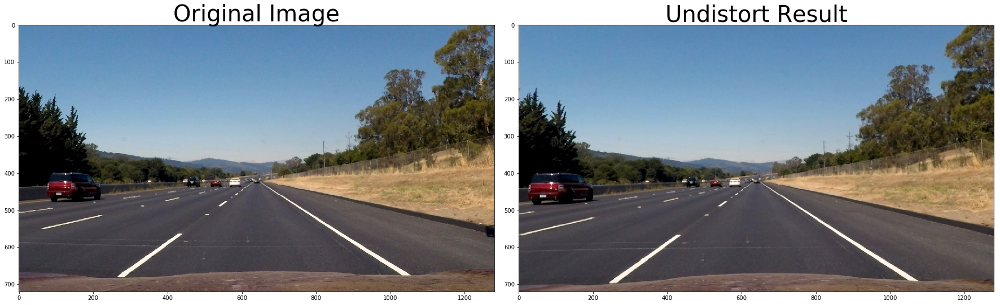

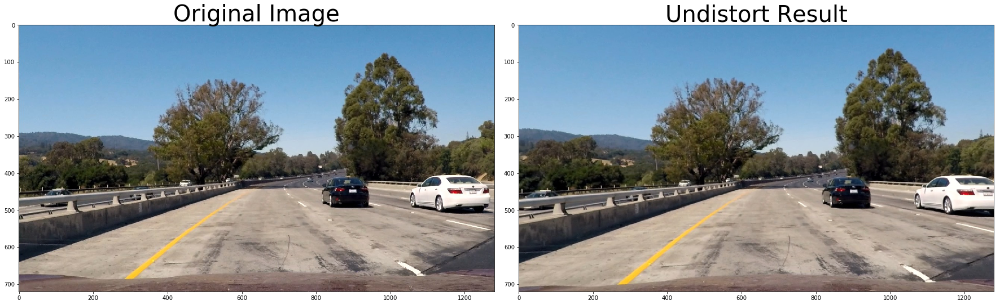

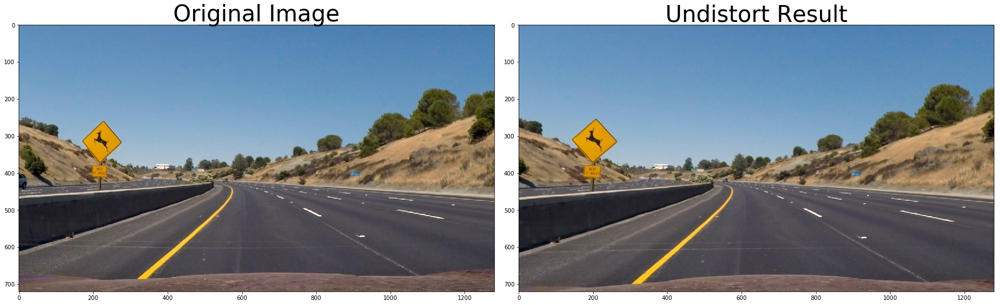

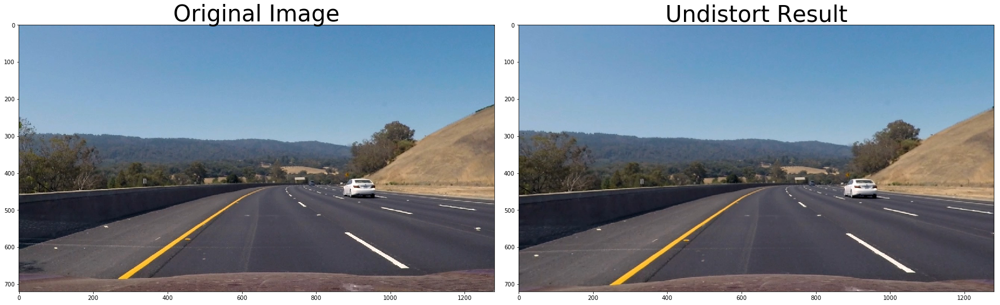

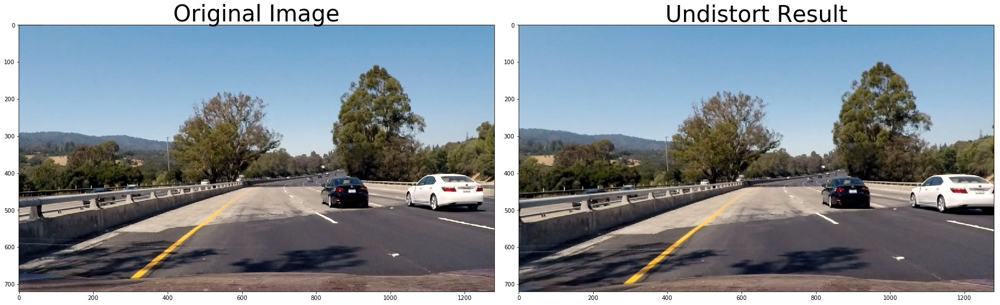

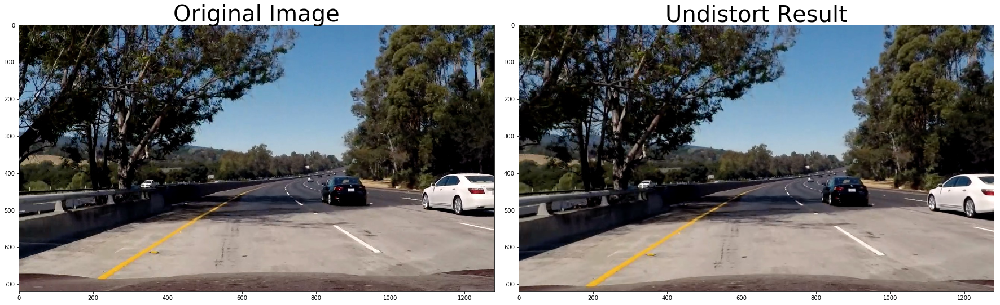

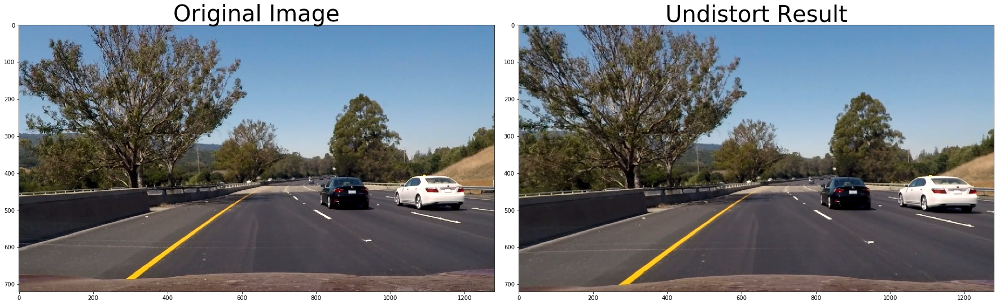

In [4]:
images = glob.glob('test_images/*.jpg')

for fname in images:
    image = mpimg.imread(fname)
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(undist)
    ax2.set_title('Undistort Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

In [5]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    if orient == 'x':
        sobel = cv2.Sobel(img, cv2.CV_64F, 1, 0)
    else:
        sobel = cv2.Sobel(img, cv2.CV_64F, 0, 1)
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))

    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return binary_output


# Function to create a thresholded binary image
def pipeline(img, s_thresh=(170, 255), v_thresh=(230, 255), x_thresh=(20, 100), sx_thresh=(20, 100)):
    img = np.copy(img)

    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY).astype(np.float)
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV).astype(np.float)
    v_channel = hsv[:, :, 2]
    # Convert to HLS color space and separate the S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    s_channel = hls[:, :, 2]

    v_binary = np.zeros_like(v_channel)
    v_binary[(v_channel >= v_thresh[0]) & (v_channel <= v_thresh[1])] = 1
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1

    ksize = 7
    gradx = abs_sobel_thresh(gray, orient='x', sobel_kernel=ksize, thresh=x_thresh)
    gradx_s = abs_sobel_thresh(v_channel, orient='x', sobel_kernel=ksize, thresh=sx_thresh)

    color_binary = np.zeros_like(s_channel)
    color_binary[(s_binary == 1) | (gradx == 1) | (gradx_s == 1) | (v_binary == 1)] = 1
    return color_binary

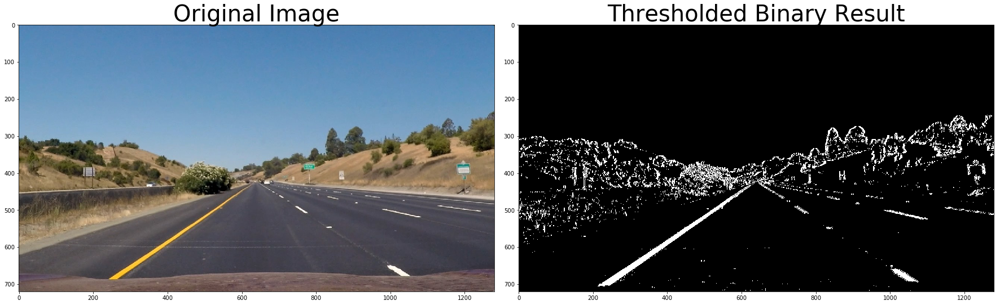

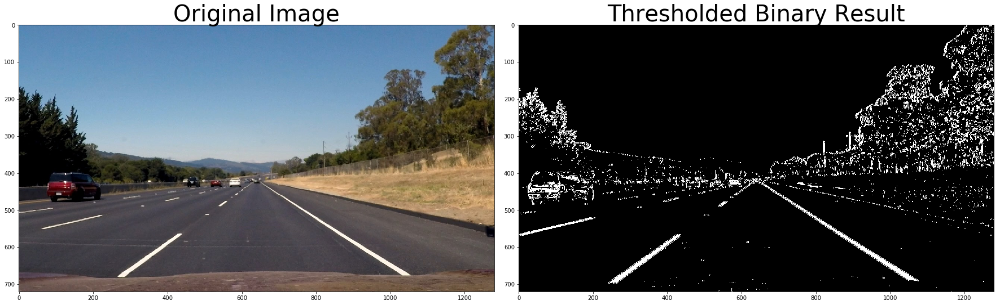

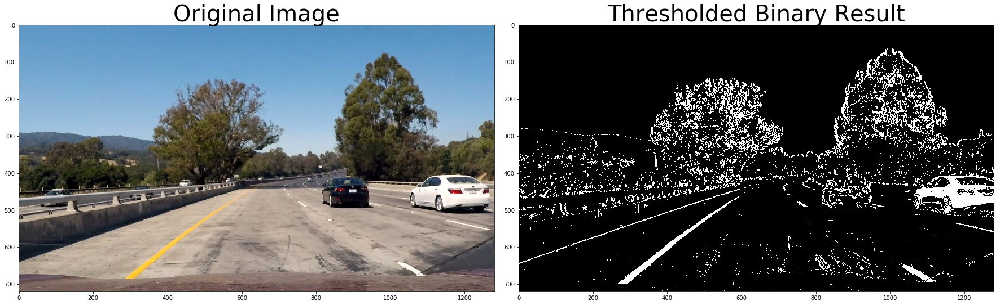

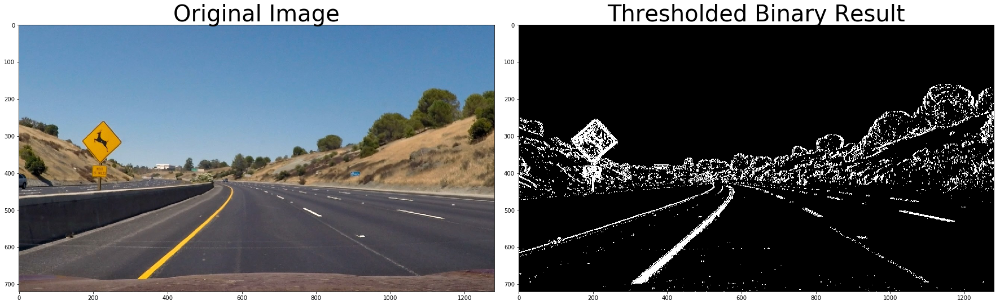

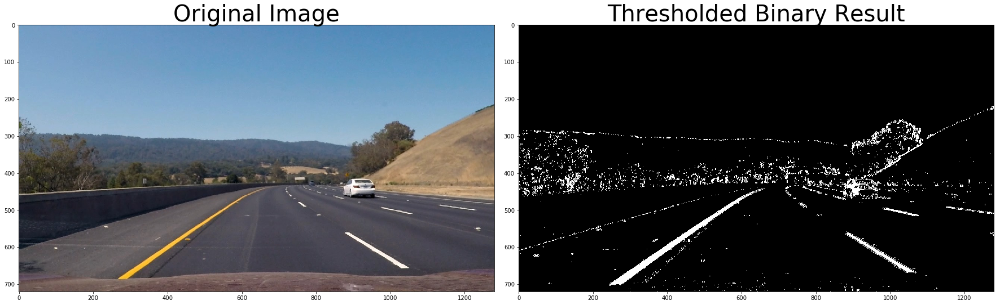

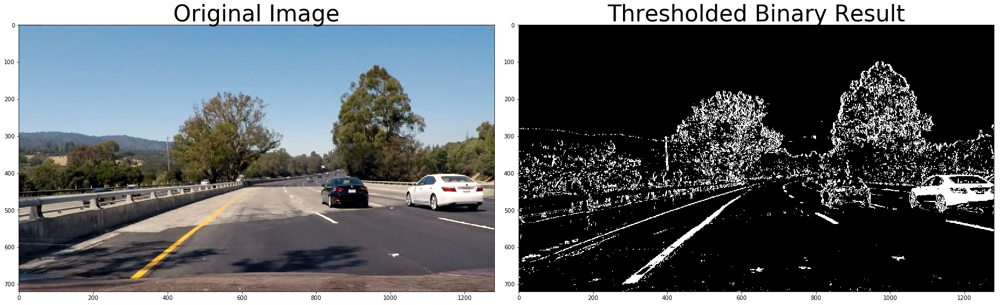

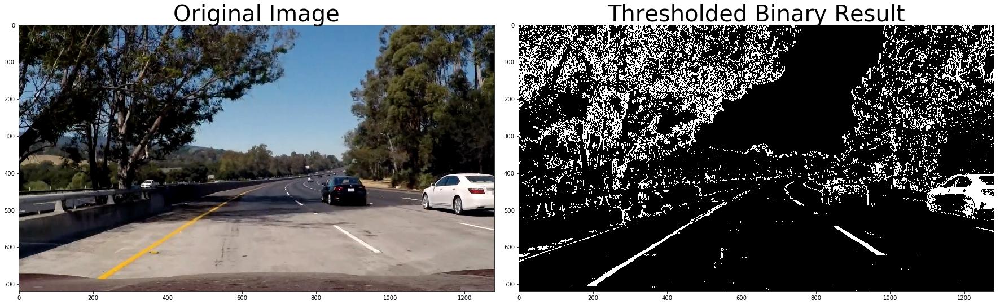

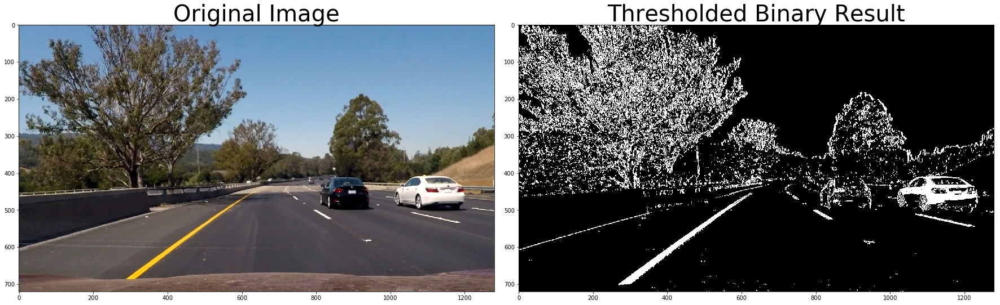

In [6]:
for fname in images:
    image = mpimg.imread(fname)
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    result = pipeline(undist, s_thresh=(170, 250))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(result, cmap='gray')
    ax2.set_title('Thresholded Binary Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

In [7]:
# ================= Compute M & Minv for perspective transform =================
offsetx = 280    # x dim offset for dst points
offsety = 0      # y dim offset for dst points
img_size = (img.shape[1], img.shape[0])
src = np.float32([(594, 449), (687, 449), (239, 703), (1086, 703)])
dst = np.float32([
    [offsetx, offsety], [img_size[0] - offsetx, offsety],
    [offsetx, img_size[1] - offsety],
    [img_size[0] - offsetx, img_size[1] - offsety]
])
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)
# ==============================================================================

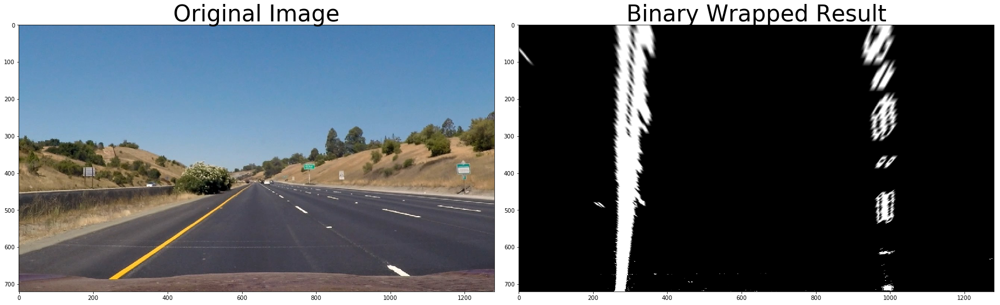

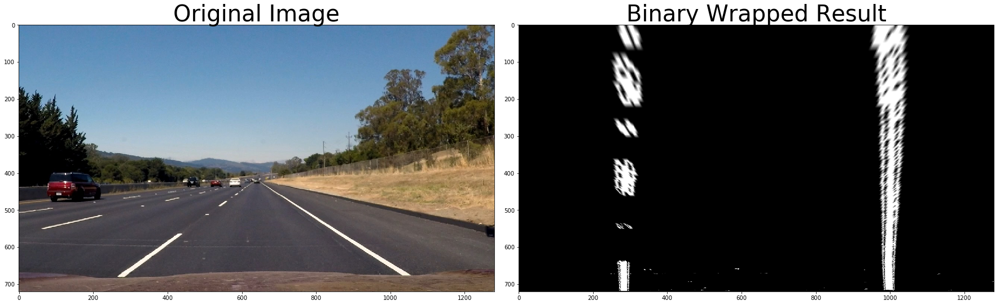

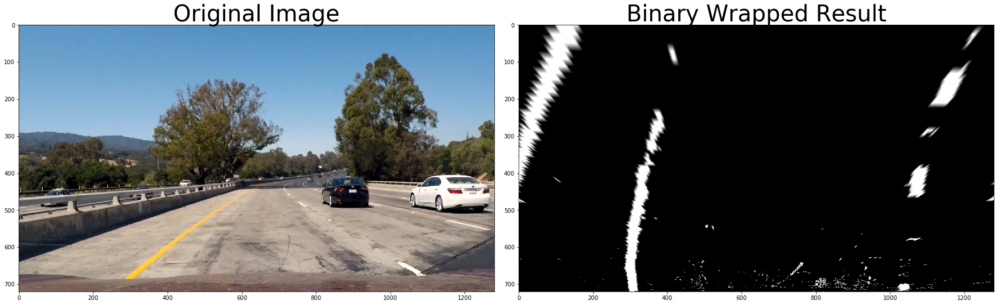

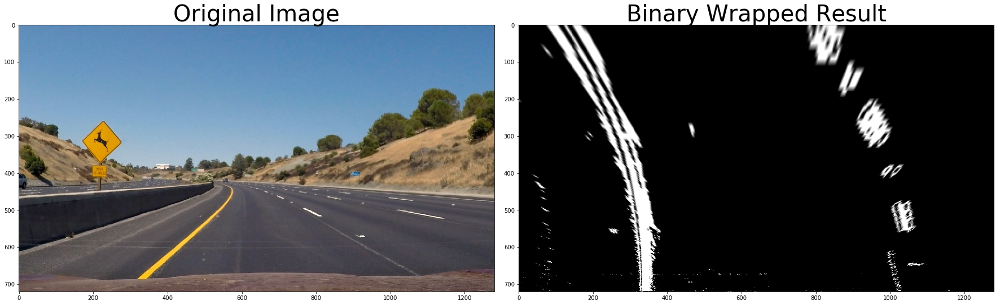

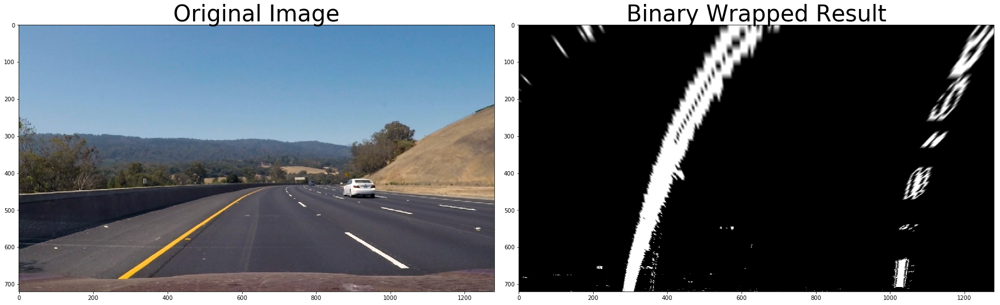

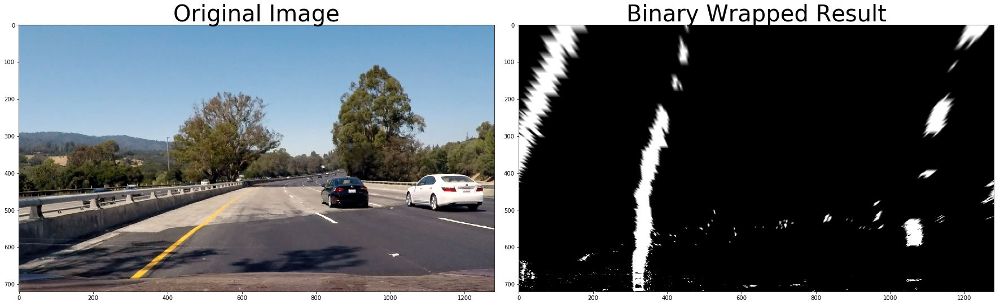

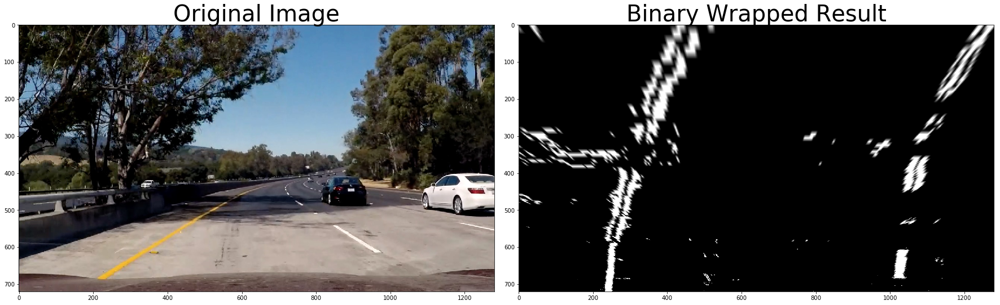

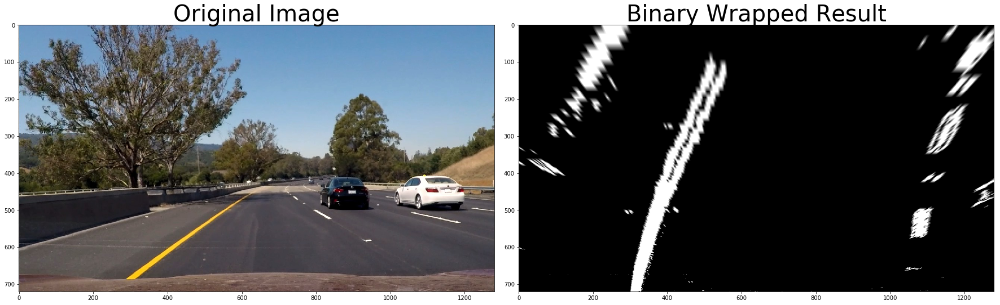

In [8]:
for fname in images:
    image = mpimg.imread(fname)
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    result = pipeline(undist, s_thresh=(170, 250))
    binary_warpped = cv2.warpPerspective(result, M, img_size, flags=cv2.INTER_LINEAR)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(binary_warpped, cmap='gray')
    ax2.set_title('Binary Wrapped Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

In [9]:
def fit_polynomial(binary_warped, nonzero):
    histogram = np.sum(binary_warped[binary_warped.shape[0] / 2:, :], axis=0)

    midpoint = np.int(histogram.shape[0] / 2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    out_img = out_img.astype(np.uint8)
    
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0] / nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        win_y_low = binary_warped.shape[0] - (window + 1) * window_height
        win_y_high = binary_warped.shape[0] - window * window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2)
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]

        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    return out_img, left_fit, right_fit, left_lane_inds, right_lane_inds

/Users/wsix/anaconda/lib/python3.6/site-packages/ipykernel/__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


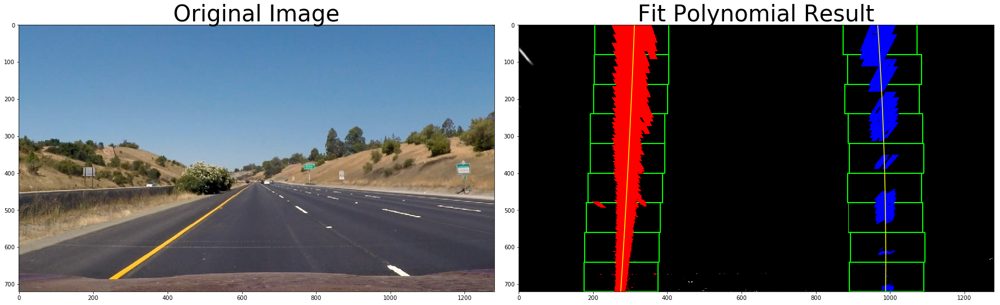

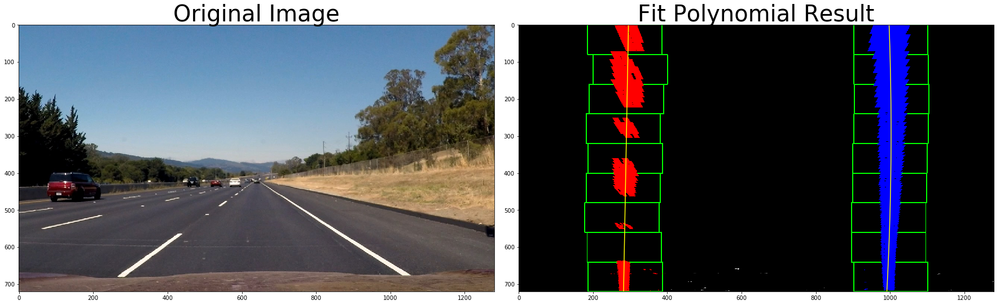

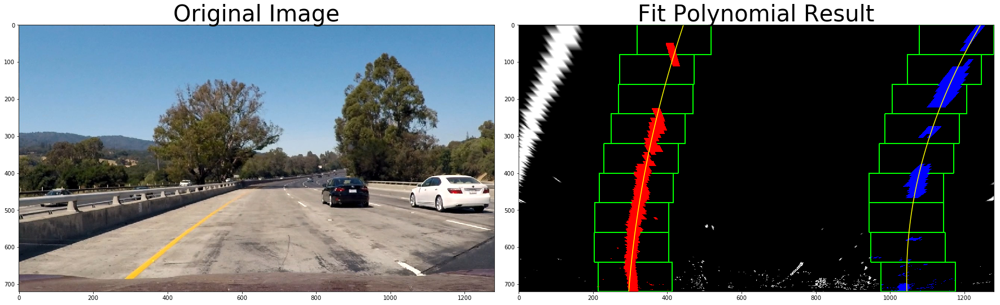

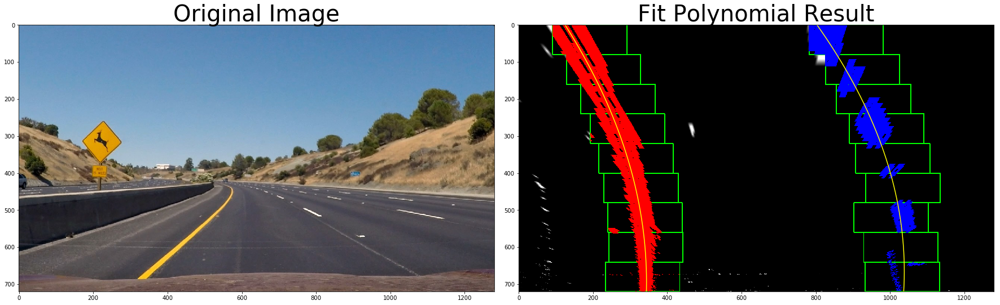

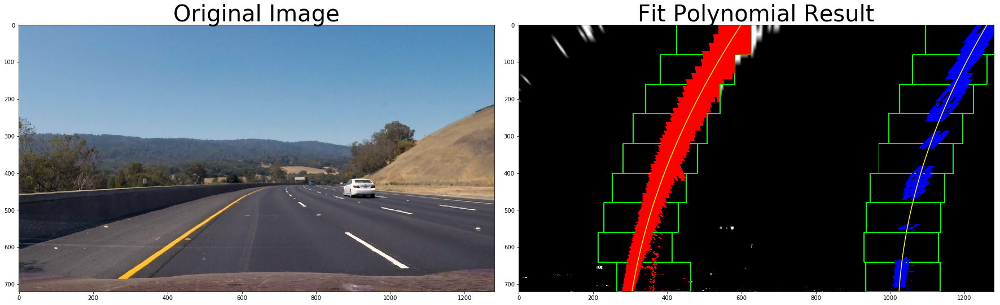

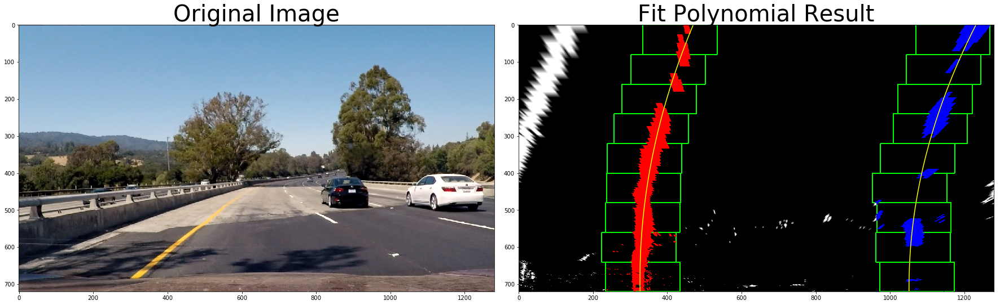

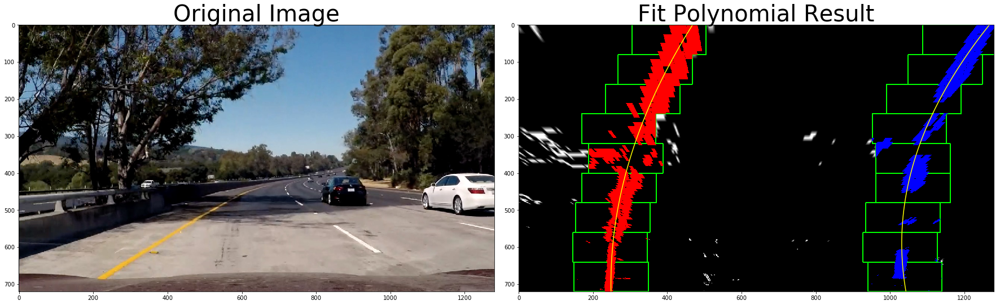

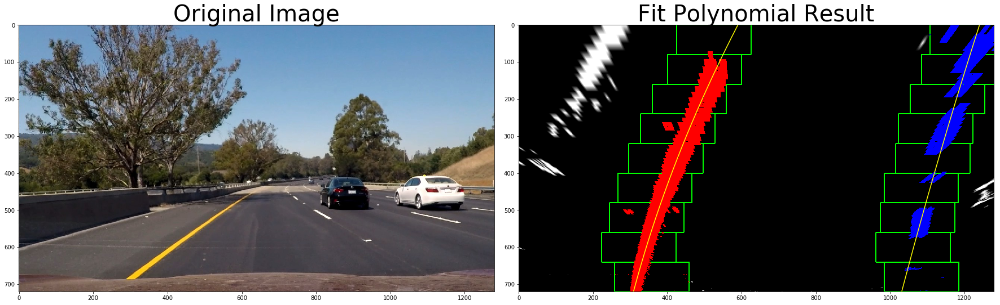

In [10]:
for fname in images:
    image = mpimg.imread(fname)
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    result = pipeline(undist, s_thresh=(170, 250))
    binary_warped = cv2.warpPerspective(result, M, img_size, flags=cv2.INTER_LINEAR)
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
    out_img, left_fit, right_fit, left_lane_inds, right_lane_inds = fit_polynomial(binary_warped, nonzero)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(out_img)
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
    ax2.set_title('Fit Polynomial Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

In [11]:
for fname in images:
    image = mpimg.imread(fname)
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    result = pipeline(undist, s_thresh=(170, 250))
    binary_warped = cv2.warpPerspective(result, M, img_size, flags=cv2.INTER_LINEAR)
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
    out_img, left_fit, right_fit, left_lane_inds, right_lane_inds = fit_polynomial(binary_warped, nonzero)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30 / 720   # meters per pixel in y dimension
    xm_per_pix = 3.7 / 720  # meters per pixel in x dimension

    y_eval = np.max(ploty)
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty * ym_per_pix, leftx * xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty * ym_per_pix, rightx * xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2 * left_fit_cr[0] * y_eval * ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2 * left_fit_cr[0])
    right_curverad = ((1 + (2 * right_fit_cr[0] * y_eval * ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2 * right_fit_cr[0])
    vehicle2center = (621 - (np.mean(left_fitx[-3:]) + np.mean(right_fitx[-3:])) / 2) * xm_per_pix
    print("Radius of Left curve is {}. Radius of Right curve is {}.".format(left_curverad, right_curverad))
    if vehicle2center >= 0:
        print('Vehicle is {:.4f}m right of center'.format(vehicle2center))
    else:
        print('Vehicle is {:.4f}m left of center'.format(-vehicle2center))

/Users/wsix/anaconda/lib/python3.6/site-packages/ipykernel/__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


Radius of Left curve is 9083.306449460253. Radius of Right curve is 3121.0548070665295.
Vehicle is 0.0527m left of center
Radius of Left curve is 392634.7867434516. Radius of Right curve is 2711.266756749539.
Vehicle is 0.0808m left of center
Radius of Left curve is 955.38395229915. Radius of Right curve is 394.58564086470597.
Vehicle is 0.2551m left of center
Radius of Left curve is 371.78976961210844. Radius of Right curve is 317.89080585894266.
Vehicle is 0.3554m left of center
Radius of Left curve is 502.19872977412047. Radius of Right curve is 462.84461850449804.
Vehicle is 0.2245m left of center
Radius of Left curve is 556.0364157912584. Radius of Right curve is 472.23029690304446.
Vehicle is 0.3481m left of center
Radius of Left curve is 375.93022651537507. Radius of Right curve is 249.74289604690819.
Vehicle is 0.1247m left of center
Radius of Left curve is 985.141852176461. Radius of Right curve is 4285.145073094418.
Vehicle is 0.2547m left of center


/Users/wsix/anaconda/lib/python3.6/site-packages/ipykernel/__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


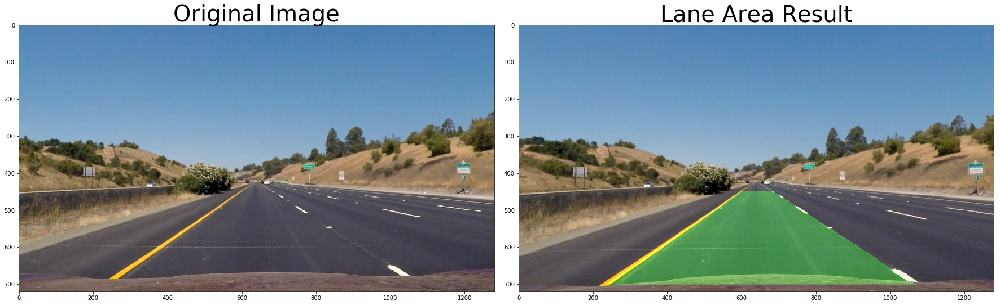

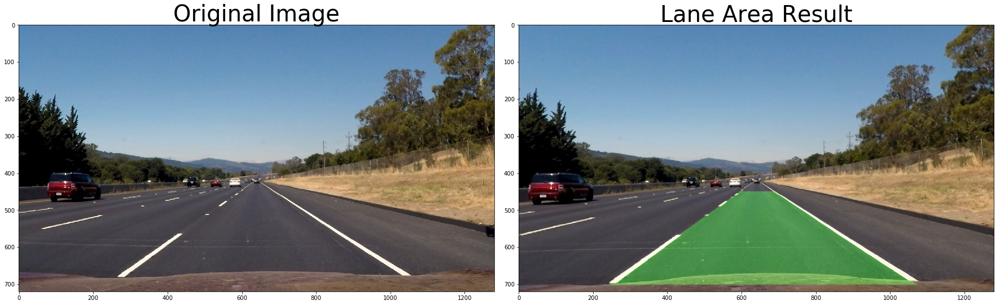

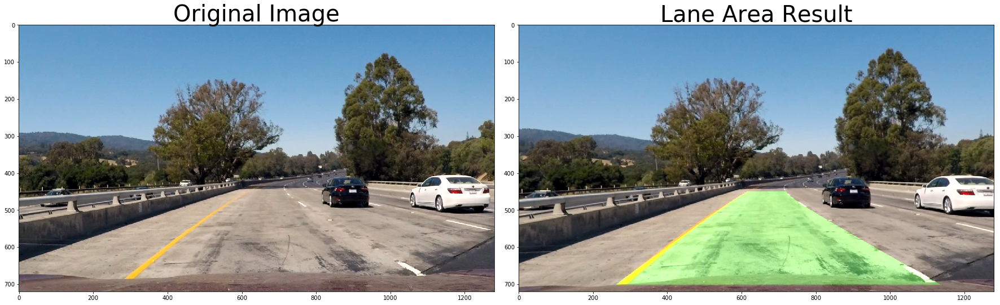

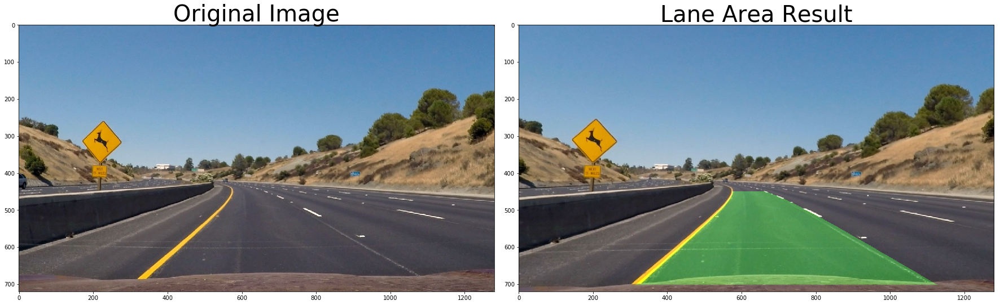

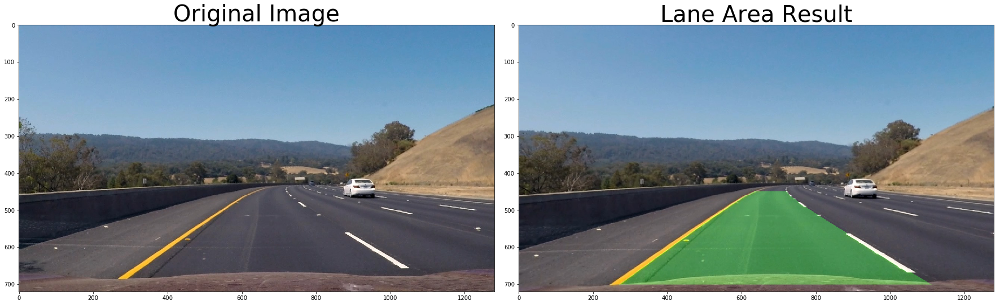

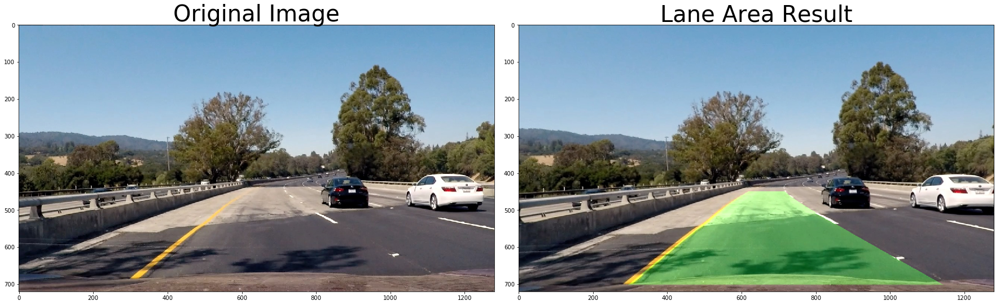

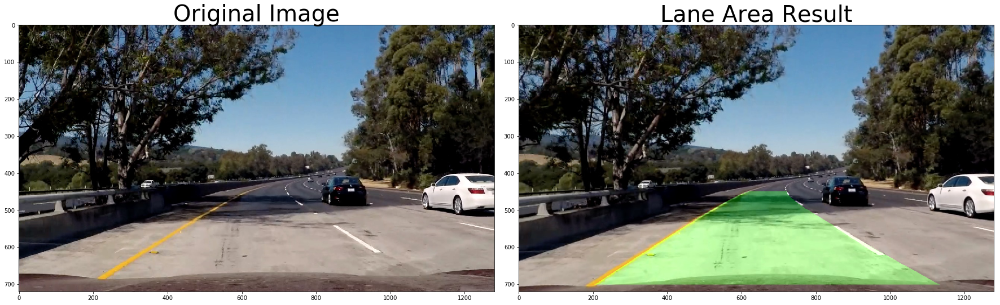

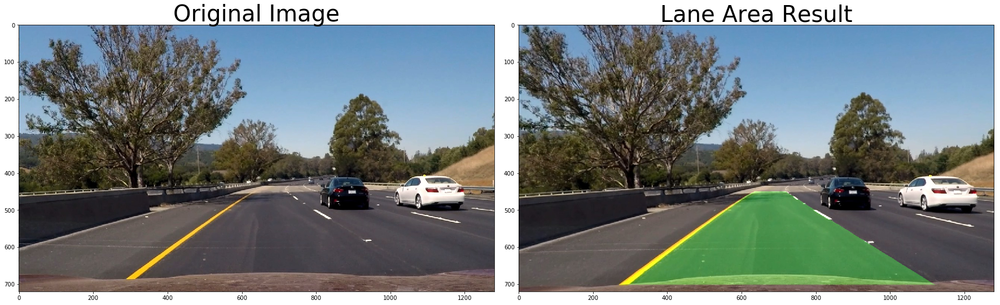

In [12]:
for fname in images:
    image = mpimg.imread(fname)
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    result = pipeline(undist, s_thresh=(170, 250))
    binary_warped = cv2.warpPerspective(result, M, img_size, flags=cv2.INTER_LINEAR)
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
    out_img, left_fit, right_fit, left_lane_inds, right_lane_inds = fit_polynomial(binary_warped, nonzero)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0]))
    output = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(output)
    ax2.set_title('Lane Area Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()